<h1 style='color:#00868b'>LDA_v3_imbalanced_more_stopwords<span class="tocSkip"></span></h1>

# Start

In [17]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

## Read and initial clean dataset

In [18]:
df = pd.read_csv("../../complaints-2020-01-22_08_24.csv", encoding="utf-8")

Example of an uncleaned comment:

In [19]:
df["Consumer complaint narrative"][52]

'I BORROWED {$200.00}, IN AN FINANCIAL EMERGENCY, FROM XXXX XXXX XXXX OFFICE IN XXXX, TN, ON XX/XX/2019. THEN ON XXXX XXXX ; AT XXXX XXXX XXXX XXXX, XXXX, XXXX XXXX, IN XXXX XXXX, TN XXXX ; I WAS TOLD MY PAYOFF IS {$210.00}, SO I PAID {$210.00}. HOWEVER, I HAVE BEEN CHARGED MUCH MORE THAN {$210.00}, ON XXXX XXXX, I PAID OFF THE LOAN IN PERSON AND MY CHECKING ACCOUNT WAS ALSO DOUBLE BILLED /CHARGED ANOTHER {$45.00}, IN XXXX , TN. \nTODAY XX/XX/2019 I WENT INTO THE XXXX   XXXX OFFICE, IN XXXX, TN AND ASKED FOR THE REIMBURSEMENT OF MY OVERBILLED MONIES AND THE CLERK NAMED " XXXX \'\' REFUSED TO REFUND MY {$45.00} OVER/ DOUBLE BILLED CHARGES! \n\nXXXX THREATENED TO HAVE ME ARRESTED IF I DID NOT LET THE OFFICE KEEP THE MONIES. MY LOAN OF {$200.00} WAS JUST FOR 40 DAYS, I WAS FORCED TO PAY A TOTAL OF {$260.00}. \nI WAS OVERBILLED/ DOUBLE BILLED {$45.00}'

In [20]:
import re
import string

def clean_document(complaint):
    # turn text to lowercase
    complaint = complaint.lower()
    # remove URLs
    complaint = re.sub('https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+', '', complaint)
    complaint = re.sub('https? ?: ?// ?(?:[-\w.]|(?:%[\da-fA-F]{2}))+', '', complaint)
    # removed censored words
    complaint = re.sub('[xxxx]{4}', '', complaint)
    complaint = re.sub('[XXXX]{4}', '', complaint)
    # remove normal dates and censored dates
    complaint = re.sub('[\dx]{0,2}/?[\dx]{0,2}/[\dx]{0,4}', '', complaint)
    # remove non-sensical characters
    complaint = re.sub('[\[\,\#\'\"\_\-\(\)\:\$\;\?\%\}\{\@\]\/\.\&\!\|]',' ', complaint)
    complaint = re.sub('\n', '', complaint)
    complaint = re.sub('\t', '', complaint)
    # remove numbers
    complaint = re.sub('[\d]', ' ', complaint)
    # normalise spaces to just one space
    complaint = re.sub(" +", " ", complaint);
    return complaint

In [21]:
df["Consumer complaint narrative"] = df["Consumer complaint narrative"].apply(clean_document)

Example of a cleaned comment:

In [22]:
df["Consumer complaint narrative"][52]

'i borrowed in an financial emergency from office in tn on then on at in tn i was told my payoff is so i paid however i have been charged much more than on i paid off the loan in person and my checking account was also double billed charged another in tn today i went into the office in tn and asked for the reimbursement of my overbilled monies and the clerk named refused to refund my over double billed charges threatened to have me arrested if i did not let the office keep the monies my loan of was just for days i was forced to pay a total of i was overbilled double billed '

In [23]:
df.shape

(485701, 18)

In [24]:
df.head()

,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,07/23/19,"Credit reporting, credit repair services, or o...",Credit reporting,Credit monitoring or identity theft protection...,Problem canceling credit monitoring or identif...,i have complained many times that the credit r...,Company has responded to the consumer and the ...,Experian Information Solutions Inc.,CA,926XX,None,Consent provided,Web,07/23/19,Closed with explanation,Yes,NaN,3315279
1,07/26/19,Debt collection,I do not know,False statements or representation,Attempted to collect wrong amount,please review the current fraud account and al...,Company believes it acted appropriately as aut...,"Ideal Collection Services, Inc.",FL,333XX,None,Consent provided,Web,07/26/19,Closed with explanation,Yes,NaN,3319487
2,06/03/19,Debt collection,I do not know,Attempts to collect debt not owed,Debt was paid,called multiple times over the years for a deb...,None,"ONEMAIN FINANCIAL HOLDINGS, LLC.",FL,327XX,None,Consent provided,Web,06/07/19,Closed with explanation,Yes,NaN,3262794
3,07/03/19,Debt collection,Other debt,Attempts to collect debt not owed,Debt was result of identity theft,i sent in a letter to the company to have them...,None,"Diversified Consultants, Inc.",VA,232XX,None,Consent provided,Web,07/03/19,Closed with explanation,Yes,NaN,3295208
4,07/14/19,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Received unsolicited financial product or insu...,on i applied for a debt relief product from th...,None,"ClearOne Advantage, LLC",PA,191XX,"Older American, Servicemember",Consent provided,Web,07/18/19,Closed with explanation,Yes,NaN,3306130


## Additional preprocessing

### Tokenize words, remove stop words and stem words 

Stemming reduces the variation in text data by converting words to their word stem. Applying stemming allows for LDA to focus much more finely on the base form of a word, rather than focusing on the differences in the various variations of a word. The code below is analagous to sprint 1's code in [<code>lemmatization.py</code>](lemmatization.py).

Stop words include: 
* common English words;
* state names;
* other frequent words that add little to no value to the context.

In [25]:
import nltk
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
import re
import string

# use nltk.download('stopwords') to download the list of stop words if this is your first time using nltk
nltk.download('stopwords')

stop_words = nltk.corpus.stopwords.words('english')
my_additional_stop_words = []

# US states, capitalised and lower
states_abbr = ["AL", "AK", "AZ", "AR", "CA", "CO", "CT", "DC", "DE", "FL", "GA", 
          "HI", "ID", "IL", "IN", "IA", "KS", "KY", "LA", "ME", "MD", 
          "MA", "MI", "MN", "MS", "MO", "MT", "NE", "NV", "NH", "NJ", 
          "NM", "NY", "NC", "ND", "OH", "OK", "OR", "PA", "RI", "SC", 
          "SD", "TN", "TX", "UT", "VT", "VA", "WA", "WV", "WI", "WY"]
states = ["Alabama","Alaska","Arizona","Arkansas","California","Colorado",
  "Connecticut","Delaware","Florida","Georgia","Hawaii","Idaho","Illinois",
  "Indiana","Iowa","Kansas","Kentucky","Louisiana","Maine","Maryland",
  "Massachusetts","Michigan","Minnesota","Mississippi","Missouri","Montana",
  "Nebraska","Nevada","New Hampshire","New Jersey","New Mexico","New York",
  "North Carolina","North Dakota","Ohio","Oklahoma","Oregon","Pennsylvania",
  "Rhode Island","South Carolina","South Dakota","Tennessee","Texas","Utah",
  "Vermont","Virginia","Washington","West Virginia","Wisconsin","Wyoming"]

states_abbr = [item.lower() for item in states_abbr]
states = [item.lower() for item in states]
states.extend(states_abbr)

# add to list of additional stop words
my_additional_stop_words.extend(states)
print("Length of extra list: ", len(my_additional_stop_words))

# add other stop words
my_additional_stop_words.extend(['from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 
                                 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 
                                 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 
                                 'right', 'line', 'even', 'also', 'may', 'take', 'come'])
print("Length of extra list: ", len(my_additional_stop_words))

# add more stop words
my_additional_stop_words.extend(['sent', 'date', 'dates', 'dated', 'state', 'states', 'days', 'years', 'months', 'asks', 
                                 'asked', 'sends', 'makes', 'two', 'three', 'mislead', 'understand', 'understands', 'misleads', 
                                 'can', 'cant', 'way', 'none', 'need', 'taken', 'poor', 'what', 'due', 'let', 'put', 'land', 
                                 'pay', 'paid', 'repay', 'well', 'made', 'make', 'wells', 'chase', 'n', 'ask', 'time', 'back', 
                                 'fargo', 'paypal', 'america', 'us', 'told', 'tell', 'tells', 'contact', 'day', 'month', 'year', 
                                 'citibank', 'citi', 'go', 'goes', 'going', 'said', 'got', 'like', 'likes', 'got', 'gots', 'gotten', 
                                 'liken', 'go', 'goes', 'going', 'number', 'ever', 'never', 'help', 'one', 'ones', 'receive', 
                                 'received', 'receives'])

# add nltk's stop words
my_stop_words = stop_words + my_additional_stop_words
print("Length of my_stop_words list: ", len(my_stop_words))

Length of extra list:  101
Length of extra list:  143
Length of my_stop_words list:  401


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\bryan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [26]:
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize 
from nltk.corpus import stopwords

ps = PorterStemmer()

i = 0
for ind, complaint in df["Consumer complaint narrative"].items():
    i = i+1
    # Tokenize the complaint and remove stop words
    words = [word for word in complaint.split(' ')
                            if word not in my_stop_words and len(word) > 2] 
    new_words = []
    # Stem the words in the complaint
    for word in words:
        new_words.append(ps.stem(word))
    df["Consumer complaint narrative"][ind] = new_words
    if (i % 10000) == 0:
        print(i)
    if(i == df["Consumer complaint narrative"].shape[0]):
        print("Done.")

# to csv for later use
df.to_csv("corpus_sprint3_cleaned_and_stemmed_v3.csv", index=False)

df.shape

C:\Users\bryan\.conda\envs\ml\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000
210000
220000
230000
240000
250000
260000
270000
280000
290000
300000
310000
320000
330000
340000
350000
360000
370000
380000
390000
400000
410000
420000
430000
440000
450000
460000
470000
480000
Done.


(485701, 18)

Example:

In [27]:
df['Consumer complaint narrative'][52]

['borrow',
 'financi',
 'emerg',
 'offic',
 'payoff',
 'howev',
 'charg',
 'much',
 'loan',
 'person',
 'check',
 'account',
 'doubl',
 'bill',
 'charg',
 'anoth',
 'today',
 'went',
 'offic',
 'reimburs',
 'overbil',
 'moni',
 'clerk',
 'name',
 'refus',
 'refund',
 'doubl',
 'bill',
 'charg',
 'threaten',
 'arrest',
 'offic',
 'keep',
 'moni',
 'loan',
 'forc',
 'total',
 'overbil',
 'doubl',
 'bill']

In [28]:
df['Consumer complaint narrative']

0         [complain, time, credit, report, experian, ina...
1         [pleas, review, current, fraud, account, fraud...
2         [call, multipl, time, debt, occur, previou, ma...
3         [letter, compani, valid, debt, special, attach...
4         [appli, debt, relief, product, account, execut...
                                ...                        
485696    [account, payday, loan, complet, request, loan...
485697    [mortgag, discharg, chapter, bankruptci, ago, ...
485698    [financ, unit, auto, credit, payment, motor, l...
485699    [automat, payment, car, loan, fine, print, sup...
485700    [reciev, collect, call, unknown, compani, morn...
Name: Consumer complaint narrative, Length: 485701, dtype: object

We have now turned every complaint into an array of its words.

In [29]:
print("nulls in df:", df["Consumer complaint narrative"].isnull().sum())

nulls in df: 0


### Creating the dictionary and corpus

The two main inputs to our LDA topic model are the Dictionary (id2word) and the corpus. Let's create them ([source](https://www.machinelearningplus.com/nlp/topic-modeling-gensim-python/)).

We remove rare words and common words based on their document frequency. Below we remove words that appear in less than 20 documents or in more than 50% of the documents.

In [30]:
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
id2word = Dictionary(df['Consumer complaint narrative'])

# Filter out words that occur less than 20 documents, or more than 50% of the documents.
id2word.filter_extremes(no_below=20, no_above=0.5)

Finally, we transform the documents to a vectorized form. We simply compute the frequency of each word.

In [31]:
# Bag-of-words representation of the documents.
corpus = [id2word.doc2bow(doc) for doc in df['Consumer complaint narrative']]

Let’s see how many tokens and documents we have to train on.

In [32]:
print('Number of unique tokens: %d' % len(id2word))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 10198
Number of documents: 485701


Each of the 485701 complaints is now represented as a 10198-dimensional vector, which means our vocabulary has 10198 words. The frequencies stated above (20 and 50% could be finetuned).

We are now ready to apply LDA.

## LDA

### Building the Topic Model

**Parameters**

Parameters ([source](https://radimrehurek.com/gensim/models/ldamulticore.html)):
* alpha (α): Topic smoothing parameter; can be set to an 1D array of length equal to the number of expected topics that expresses our a-priori belief for the each topics’ probability
* eta (η): Word/term smoothing parameter; a scalar for a symmetric prior over topic/word probability

Most topic modeling analyses in the literature ([Blei et al, 2003](https://www.researchgate.net/publication/326505884_Latent_Dirichlet_Allocation_LDA_for_Topic_Modeling_of_the_CFPB_Consumer_Complaints); [Blei and Lafferty, 2009](https://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.463.1205&rep=rep1&type=pdf#page=96); [Kaplan and Vakili, 2015](https://onlinelibrary.wiley.com/doi/abs/10.1002/smj.2294); [Blei, 2012](https://dl.acm.org/doi/pdf/10.1145/2133806.2133826)) suggest a value of 0.1 for both of these hyperparameters. This results in semantically meaningful topics. However, these values can also be set to 'auto', meaning we would automatically learn these two parameters.

Other parameters:

* number of topics: The number of topics LDA has to attempt to identify
* iterations: Maximum number of iterations through the corpus when inferring the topic distribution of a corpus
* passes: Number of passes through the corpus during training

([Source](https://radimrehurek.com/gensim/auto_examples/tutorials/run_lda.html)):

<code>chunksize</code> controls how many documents are processed at a time in the training algorithm. Increasing chunksize will speed up training, at least as long as the chunk of documents easily fit into memory. Chunksize can however influence the quality of the model, as discussed in Hoffman and co-authors ([source](https://papers.nips.cc/paper/3902-online-learning-for-latent-dirichlet-allocation.pdf)).

<code>passes</code> controls how often we train the model on the entire corpus. Another word for passes might be “epochs”. <code>iterations</code> is somewhat technical, but essentially it controls how often we repeat a particular loop over each document.

**Optimals number of topics**

Finding the optimal number of topics can be done by building many LDA models with different values of number of topics (k) and pick the one that gives the highest coherence value.

Choosing a ‘k’ that marks the end of a rapid growth of topic coherence usually offers meaningful and interpretable topics. Picking an even higher value can sometimes provide more granular sub-topics.

Seeing the same keywords being repeated in multiple topics, probably indicates that the ‘k’ is too large.

The compute_coherence_values() (see below) trains multiple LDA models and provides the models and their corresponding coherence scores.

**Keyswords and weightage**

We will also look at the **keywords** for each topic and the **weightage** (importance) of each keyword using lda_model.print_topics(). The output below show us what the top 10 keywords are that contribute to a topic. The weights reflect how important a keyword is to that topic.

**Model Perplexity** and **Topic Coherence**

Additionally, the **model perplexity** and **topic coherence** are printed. These provide a convenient measure to judge how good a given topic model is.

**LDA type**

We use **parallelized Latent Dirichlet Allocation** which uses multiprocessing to speed up learning ([source](https://radimrehurek.com/gensim/models/ldamulticore.html)).

In [ ]:
from gensim import corpora, models
from gensim.models import CoherenceModel

# Training parameters
alpha = 0.1
eta = 0.1
#alpha = 'auto'
#eta = 'auto'
chunksize = 2000
iterations = 69
passes = 20

######################
# function that produces LDA models & computes coherence values
def compute_coherence_values(dictionary, corpus, texts, limit, start, step):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics -2

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    
    # Run model for different values for number of topics
    for num_topics in range(start, limit, step):
        print("Start with number of topics:", num_topics)
        # train
        lda_model = models.LdaMulticore(
                    corpus = corpus,
                    id2word = dictionary,
                    num_topics = num_topics, 
                    passes = passes,
                    iterations = iterations,
                    alpha = alpha, 
                    eta = eta,
                    random_state = 42
                   )
        # append to list of models
        model_list.append(lda_model)
        # save the trained model
        print("Saving the model...")
        lda_model.save("models/v3/lda_model_" + str(num_topics) + "topics")
        # Compute Perplexity
        print("Computing complexity...")
        print('Perplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.
        # Compute Coherence
        print("Computing coherence...")
        coherence_model_lda = CoherenceModel(model=lda_model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherence_model_lda.get_coherence())
        print('Coherence Score: ', coherence_model_lda.get_coherence())
        # Print the 10 most prominent topics for a given model
        for idx, topic in lda_model.print_topics(-1):
            print('\nTopic: {} \nWords: {}'.format(idx, topic))
        print("************************************************")
        
    return model_list, coherence_values
######################

# Run function (this will take some time)
model_list, coherence_values = compute_coherence_values(dictionary=id2word, 
                                                        corpus=corpus, 
                                                        texts=df['Consumer complaint narrative'].tolist(), 
                                                        start=8, 
                                                        step=2,
                                                        limit=30)

Start with number of topics: 8
Saving the model...
Computing complexity...
Perplexity:  -6.654033117788847
Computing coherence...
Coherence Score:  0.5103235518950517

Topic: 0 
Words: 0.016*"court" + 0.015*"file" + 0.013*"law" + 0.010*"complaint" + 0.010*"attorney" + 0.010*"bankruptci" + 0.009*"case" + 0.008*"legal" + 0.008*"record" + 0.008*"document"

Topic: 1 
Words: 0.103*"payment" + 0.052*"loan" + 0.023*"late" + 0.019*"interest" + 0.017*"amount" + 0.015*"balanc" + 0.010*"fee" + 0.009*"monthli" + 0.009*"rate" + 0.008*"charg"

Topic: 2 
Words: 0.066*"call" + 0.020*"phone" + 0.014*"compani" + 0.012*"inform" + 0.010*"tri" + 0.010*"work" + 0.008*"email" + 0.008*"name" + 0.008*"state" + 0.008*"bill"

Topic: 3 
Words: 0.093*"consum" + 0.065*"inform" + 0.057*"ident" + 0.054*"report" + 0.048*"theft" + 0.032*"section" + 0.031*"block" + 0.030*"agenc" + 0.021*"victim" + 0.018*"file"

Topic: 4 
Words: 0.108*"report" + 0.030*"remov" + 0.029*"inform" + 0.025*"disput" + 0.020*"inquiri" + 0.017*"b

Saving the model...
Computing complexity...
Perplexity:  -6.589895791727994
Computing coherence...
Coherence Score:  0.5117276705533174

Topic: 0 
Words: 0.014*"complaint" + 0.012*"law" + 0.010*"file" + 0.009*"case" + 0.009*"court" + 0.009*"action" + 0.008*"legal" + 0.008*"cfpb" + 0.008*"financi" + 0.008*"violat"

Topic: 1 
Words: 0.217*"payment" + 0.051*"late" + 0.029*"amount" + 0.018*"balanc" + 0.016*"monthli" + 0.015*"statement" + 0.010*"interest" + 0.009*"appli" + 0.009*"show" + 0.009*"past"

Topic: 2 
Words: 0.055*"call" + 0.018*"email" + 0.018*"inform" + 0.017*"phone" + 0.013*"servic" + 0.012*"state" + 0.011*"repres" + 0.011*"custom" + 0.011*"spoke" + 0.011*"letter"

Topic: 3 
Words: 0.071*"call" + 0.026*"compani" + 0.021*"phone" + 0.015*"work" + 0.015*"debt" + 0.013*"tri" + 0.012*"owe" + 0.011*"money" + 0.011*"name" + 0.010*"stop"

Topic: 4 
Words: 0.156*"report" + 0.047*"remov" + 0.036*"inquiri" + 0.024*"bureau" + 0.023*"disput" + 0.019*"inform" + 0.018*"score" + 0.017*"show" +

**Show the graph for Coherence Scores**

In [ ]:
# Show graph

limit=30; start=8; step=2;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

**Print the Coherence Scores**

In [ ]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

### Visualize the topics-keywords

#### PyLDAvis visualisation

We can use the PyLDAvis package to visualize our topics.

[Source](https://www.machinelearningplus.com/nlp/topic-modeling-gensim-python/)

Each bubble on the left-hand side plot represents a topic. The larger the bubble, the more prevalent is that topic. A good topic model will have fairly big, non-overlapping bubbles scattered throughout the chart instead of being clustered in one quadrant.

A model with too many topics, will typically have many overlaps, small sized bubbles clustered in one region of the chart.

If you move the cursor over one of the bubbles, the words and bars on the right-hand side will update. These words are the salient keywords that form the selected topic.

Use <code>conda install -c conda-forge pyldavis</code> to install the pyLDAvis package.

**Load the model with the highest coherence score**

In [34]:
from gensim.test.utils import datapath
from gensim import corpora, models
from gensim.models import CoherenceModel

# load saved model
lda_model22 = models.LdaMulticore.load("models/v3/lda_model_" + str(22) +"topics")

**Topics and keywords for the model with 22 topics**

In [35]:
for idx, topic in lda_model22.print_topics(-1):
            print('\nTopic: {} \nWords: {}'.format(idx, topic))


Topic: 0 
Words: 0.038*"court" + 0.034*"bankruptci" + 0.032*"file" + 0.026*"attorney" + 0.022*"law" + 0.016*"case" + 0.015*"record" + 0.012*"legal" + 0.011*"document" + 0.011*"lien"

Topic: 1 
Words: 0.133*"debt" + 0.110*"collect" + 0.041*"owe" + 0.040*"compani" + 0.031*"agenc" + 0.024*"amount" + 0.019*"bill" + 0.015*"letter" + 0.015*"origin" + 0.011*"collector"

Topic: 2 
Words: 0.096*"card" + 0.020*"capit" + 0.018*"custom" + 0.018*"servic" + 0.016*"offer" + 0.016*"onlin" + 0.015*"open" + 0.013*"close" + 0.012*"new" + 0.011*"point"

Topic: 3 
Words: 0.013*"financi" + 0.011*"consum" + 0.011*"complaint" + 0.010*"inform" + 0.010*"servic" + 0.009*"practic" + 0.008*"protect" + 0.008*"provid" + 0.008*"busi" + 0.007*"person"

Topic: 4 
Words: 0.179*"report" + 0.042*"remov" + 0.032*"disput" + 0.030*"bureau" + 0.027*"inform" + 0.024*"score" + 0.022*"show" + 0.015*"neg" + 0.014*"correct" + 0.013*"still"

Topic: 5 
Words: 0.065*"mortgag" + 0.054*"loan" + 0.036*"home" + 0.024*"modif" + 0.016*"pr

**Visualize it**

In [36]:
import pyLDAvis
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline

# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model22, corpus, id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6      0.179297 -0.064971       1        1  8.671930
17     0.091530 -0.105312       2        1  7.971859
3     -0.002736  0.037600       3        1  7.187513
14    -0.060477 -0.057171       4        1  6.985960
4     -0.121296 -0.162278       5        1  6.234056
5      0.127521  0.072719       6        1  6.201352
18     0.136861 -0.022177       7        1  5.510100
2      0.145451 -0.062880       8        1  4.845119
1     -0.041152 -0.046140       9        1  4.384937
10    -0.270332 -0.042058      10        1  4.373589
21    -0.188851 -0.138271      11        1  4.244716
20     0.138463 -0.100337      12        1  4.152293
16     0.170575  0.015472      13        1  4.146926
7     -0.240204  0.035437      14        1  3.996440
0     -0.098589  0.142050      15        1  3.752076
13     0.172911 -0.014065      16        1  3.571203
19     0.182668 -0.052942      17        1  3.481562
8      0.007946 -0.025979      18        1  3.044131
12     0.097561  0.126662      19        1  2.656191
9     -0.262509 -0.020801      20        1  2.097355
15    -0.202934  0.118361      21        1  1.386105
11     0.038297  0.367080      22        1  1.104582, topic_info=        Term           Freq          Total Category  logprob  loglift
124  payment  504586.000000  504586.000000  Default  30.0000  30.0000
59    report  638137.000000  638137.000000  Default  29.0000  29.0000
171     loan  374223.000000  374223.000000  Default  28.0000  28.0000
86      call  451526.000000  451526.000000  Default  27.0000  27.0000
18      debt  271865.000000  271865.000000  Default  26.0000  26.0000
..       ...            ...            ...      ...      ...      ...
93      home    9516.675781  102574.953125  Topic22  -3.6418   2.1282
913   refund    6124.631348   40476.230469  Topic22  -4.0825   2.6173
959     sale    3790.878906   36549.726562  Topic22  -4.5623   2.2396
608  receipt    2995.430908   26045.871094  Topic22  -4.7978   2.3429
85    bought    2088.103027   10040.843750  Topic22  -5.1586   2.9353

[1641 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
1718      5  0.115883         ****
1718     10  0.880944         ****
9541     11  0.984522  ***********
6353     11  0.997979         <p>i
8475      4  0.950213          >in
...     ...       ...          ...
232      17  0.000084        wrote
232      18  0.000084        wrote
232      19  0.017385        wrote
573       1  0.059256         yell
573       2  0.939700         yell

[6635 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 18, 4, 15, 5, 6, 19, 3, 2, 11, 22, 21, 17, 8, 1, 14, 20, 9, 13, 10, 16, 12])

This model shows overlap on the pyLDAvis, however, this could be because certain keywords such as 'credit' appear in both a topic such as credit card and a topic such as credit for loans. Or a keyword such as 'loan' appearing in both a topic such as 'student loans' and 'mortgage/house loans'. Including bigrams could potentially help fix these overlaps.

**Load another model.**

In [37]:
from gensim.test.utils import datapath

# load saved model
lda_model8 = models.LdaMulticore.load("models/v3/lda_model_" + str(8) +"topics")

**Topics and keywords for the model with 8 topics**

In [38]:
for idx, topic in lda_model8.print_topics(-1):
            print('\nTopic: {} \nWords: {}'.format(idx, topic))


Topic: 0 
Words: 0.016*"court" + 0.015*"file" + 0.013*"law" + 0.010*"complaint" + 0.010*"attorney" + 0.010*"bankruptci" + 0.009*"case" + 0.008*"legal" + 0.008*"record" + 0.008*"document"

Topic: 1 
Words: 0.103*"payment" + 0.052*"loan" + 0.023*"late" + 0.019*"interest" + 0.017*"amount" + 0.015*"balanc" + 0.010*"fee" + 0.009*"monthli" + 0.009*"rate" + 0.008*"charg"

Topic: 2 
Words: 0.066*"call" + 0.020*"phone" + 0.014*"compani" + 0.012*"inform" + 0.010*"tri" + 0.010*"work" + 0.008*"email" + 0.008*"name" + 0.008*"state" + 0.008*"bill"

Topic: 3 
Words: 0.093*"consum" + 0.065*"inform" + 0.057*"ident" + 0.054*"report" + 0.048*"theft" + 0.032*"section" + 0.031*"block" + 0.030*"agenc" + 0.021*"victim" + 0.018*"file"

Topic: 4 
Words: 0.108*"report" + 0.030*"remov" + 0.029*"inform" + 0.025*"disput" + 0.020*"inquiri" + 0.017*"bureau" + 0.016*"equifax" + 0.015*"file" + 0.012*"experian" + 0.012*"compani"

Topic: 5 
Words: 0.037*"mortgag" + 0.030*"loan" + 0.020*"home" + 0.012*"modif" + 0.011*"d

**Visualize it**

In [51]:
import pyLDAvis
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline

# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model8, corpus, id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.157391 -0.078700       1        1  18.425606
6      0.106065 -0.027988       2        1  16.176128
1      0.183375 -0.056122       3        1  14.162429
4     -0.084673 -0.124278       4        1  13.378768
5      0.137364  0.045075       5        1  13.193150
7     -0.101942  0.063347       6        1  11.952987
0     -0.028512  0.238813       7        1   9.133232
3     -0.369069 -0.060147       8        1   3.577703, topic_info=         Term           Freq          Total Category  logprob  loglift
59     report  642919.000000  642919.000000  Default  30.0000  30.0000
124   payment  498085.000000  498085.000000  Default  29.0000  29.0000
18       debt  280866.000000  280866.000000  Default  28.0000  28.0000
86       call  454763.000000  454763.000000  Default  27.0000  27.0000
171      loan  372666.000000  372666.000000  Default  26.0000  26.0000
..        ...            ...            ...      ...      ...      ...
52     provid    9133.690430  162153.562500   Topic8  -4.8543   0.4539
50     person    8236.834961   98939.601562   Topic8  -4.9577   0.8446
565  transact    7385.913086   57002.207031   Topic8  -5.0667   1.2869
13    compani    7798.504395  264087.656250   Topic8  -5.0124  -0.1919
63     servic    7259.205078  178194.734375   Topic8  -5.0840   0.1298

[636 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
3491      1  0.998691  aadvantag
6747      3  0.999715         ac
3076      2  0.050296        acc
3076      4  0.154153        acc
3076      6  0.000653        acc
...     ...       ...        ...
211       4  0.000475       work
211       5  0.176628       work
211       7  0.015424       work
8680      8  0.998195       xoom
573       1  0.999802       yell

[1725 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 7, 2, 5, 6, 8, 1, 4])

**Load another model.**

In [52]:
from gensim.test.utils import datapath

# load saved model
lda_model20 = models.LdaMulticore.load("models/v3/lda_model_" + str(20) +"topics")

**Topics and keywords for the model with 20 topics**

In [53]:
for idx, topic in lda_model20.print_topics(-1):
            print('\nTopic: {} \nWords: {}'.format(idx, topic))


Topic: 0 
Words: 0.028*"court" + 0.022*"law" + 0.021*"attorney" + 0.020*"file" + 0.014*"legal" + 0.013*"case" + 0.011*"record" + 0.010*"document" + 0.009*"note" + 0.009*"lien"

Topic: 1 
Words: 0.147*"report" + 0.030*"balanc" + 0.030*"score" + 0.026*"show" + 0.024*"bureau" + 0.022*"late" + 0.020*"remov" + 0.020*"inform" + 0.019*"close" + 0.017*"open"

Topic: 2 
Words: 0.127*"card" + 0.018*"capit" + 0.015*"offer" + 0.014*"purchas" + 0.014*"custom" + 0.014*"charg" + 0.014*"close" + 0.013*"open" + 0.011*"call" + 0.011*"servic"

Topic: 3 
Words: 0.014*"financi" + 0.012*"servic" + 0.011*"consum" + 0.011*"complaint" + 0.010*"provid" + 0.009*"practic" + 0.009*"inform" + 0.008*"busi" + 0.008*"custom" + 0.007*"protect"

Topic: 4 
Words: 0.113*"report" + 0.077*"remov" + 0.076*"inquiri" + 0.031*"equifax" + 0.030*"experian" + 0.025*"compani" + 0.024*"disput" + 0.024*"transunion" + 0.023*"author" + 0.018*"hard"

Topic: 5 
Words: 0.064*"mortgag" + 0.053*"loan" + 0.034*"home" + 0.022*"modif" + 0.017

**Visualize it**

In [54]:
import pyLDAvis
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline

# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model20, corpus, id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6      0.185753  0.087833       1        1  9.053018
17     0.112772  0.040295       2        1  7.815844
14    -0.040967 -0.024089       3        1  7.461213
3      0.023159 -0.116596       4        1  7.143120
19     0.185893  0.060282       5        1  6.885292
5      0.147485 -0.077594       6        1  6.845034
18     0.153581  0.014688       7        1  6.362256
7     -0.146696 -0.106142       8        1  5.473945
10    -0.259959 -0.039618       9        1  5.454657
1     -0.064055  0.161723      10        1  5.364455
2      0.172591  0.007798      11        1  5.326878
16     0.185593 -0.023101      12        1  4.816778
0     -0.049547 -0.242248      13        1  4.329089
8     -0.138441  0.063617      14        1  3.787374
4     -0.183194  0.168807      15        1  3.539685
13     0.188276 -0.033349      16        1  3.240261
12     0.065488 -0.047207      17        1  2.396597
9     -0.268999  0.024621      18        1  2.177412
15    -0.180697 -0.184078      19        1  1.495480
11    -0.088035  0.264358      20        1  1.031612, topic_info=        Term           Freq          Total Category  logprob  loglift
124  payment  500840.000000  500840.000000  Default  30.0000  30.0000
59    report  641652.000000  641652.000000  Default  29.0000  29.0000
171     loan  373949.000000  373949.000000  Default  28.0000  28.0000
86      call  452484.000000  452484.000000  Default  27.0000  27.0000
18      debt  269750.000000  269750.000000  Default  26.0000  26.0000
..       ...            ...            ...      ...      ...      ...
443   matter    3687.297852   50273.597656  Topic20  -4.5215   1.9615
13   compani    4316.790039  262979.000000  Topic20  -4.3638   0.4645
191   resolv    3197.903809   54286.675781  Topic20  -4.6639   1.7423
124  payment    3666.500244  500840.781250  Topic20  -4.5271  -0.3430
633    score    3180.633301   61996.421875  Topic20  -4.6693   1.6041

[1491 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1718     20  0.997415       ****
7258      3  0.974715     ******
8107      3  0.973956     *pleas
3491     11  0.997937  aadvantag
1439      1  0.060408       abus
...     ...       ...        ...
232      15  0.025163      wrote
232      16  0.012917      wrote
232      17  0.019711      wrote
573       1  0.062516       yell
573       2  0.936170       yell

[5836 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 18, 15, 4, 20, 6, 19, 8, 11, 2, 3, 17, 1, 9, 5, 14, 13, 10, 16, 12])

#### t-SNE clustering chart

We will use the **models with 8 and 22 topics** for these visualisations.

Add package **bokeh** with: <code>conda install bokeh</code>

**Model with 8 topics**

In [40]:
from gensim.test.utils import datapath

# load saved model
lda_model8 = models.LdaMulticore.load("models/v3/lda_model_" + str(8) +"topics")

In [41]:
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
import matplotlib.colors as mcolors

n_topics = lda_model8.num_topics

# Get topic weights
topic_weights = []
for row_list in lda_model8[corpus]:
    tmp = np.zeros(n_topics)
    for i, w in row_list:
        tmp[i] = w
    topic_weights.append(tmp)

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2)
tsne_lda = tsne_model.fit_transform(arr)

**Visualisation**

In [42]:
# Plot the Topic Clusters using Bokeh
output_notebook()
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
print(len(mycolors))
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=900, plot_height=700)
t = np.arange(n_topics)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num])
show(plot)

Loading BokehJS ...

10


**Model with 22 topics**

In [43]:
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
import matplotlib.colors as mcolors

n_topics = lda_model22.num_topics

# Get topic weights
topic_weights = []
for row_list in lda_model22[corpus]:
    tmp = np.zeros(n_topics)
    for i, w in row_list:
        tmp[i] = w
    topic_weights.append(tmp)

# Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2)
tsne_lda = tsne_model.fit_transform(arr)

**Visualisation**

In [44]:
# Plot the Topic Clusters using Bokeh
output_notebook()
mycolors = np.array([color for name, color in mcolors.XKCD_COLORS.items()])
print(len(mycolors))
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=900, plot_height=700)
t = np.arange(n_topics)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num*25])
show(plot)

Loading BokehJS ...

949


#### Word clouds

Although we have already seen the keywords for each topic, a word cloud with the size of the words proportional to the weight is a pleasant sight. Let's print the 10 most prominent words for every topic.

Add package **wordcloud** with: <code>pip install wordcloud</code>

**Model with 8 keywords**

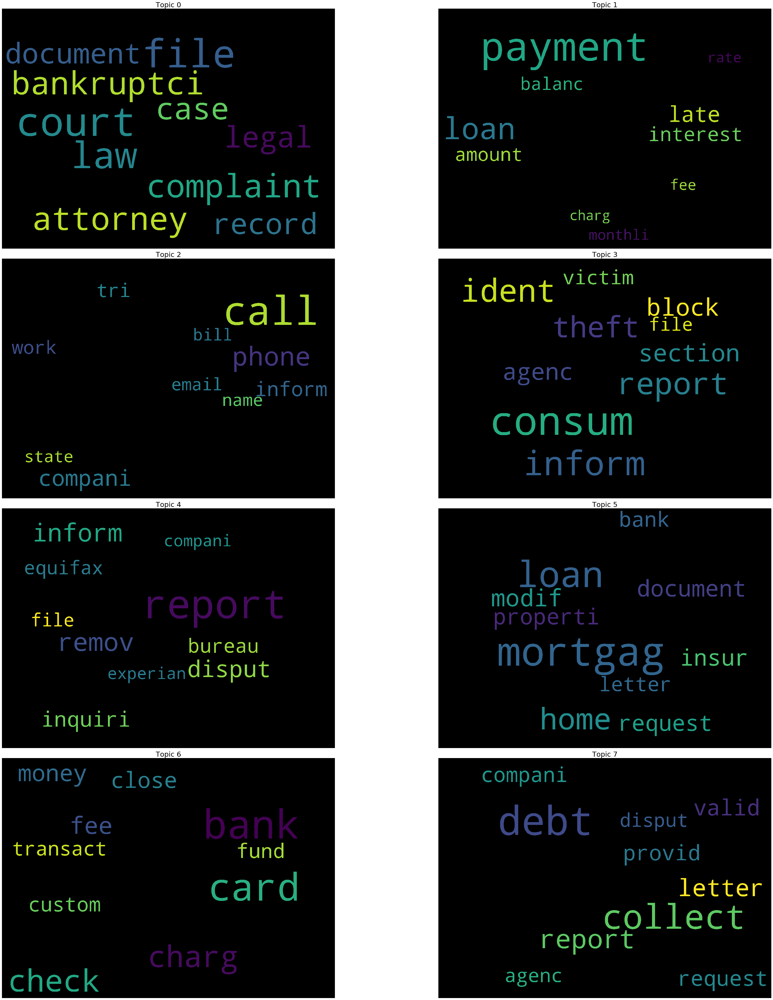

In [45]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.BASE_COLORS.items()]

cloud = WordCloud(stopwords=stop_words,
                  width=2500,
                  height=1800,
                  max_words=10,
                  #colormap='tab10',
                  #color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model8.show_topics(num_topics=lda_model8.num_topics, formatted=False,)

fig, axes = plt.subplots(4, 2, figsize=(50,50), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=25))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

At this point, a field expert could be able to help label these topics. 

For instance: 

* ...

**Model with 22 keywords**

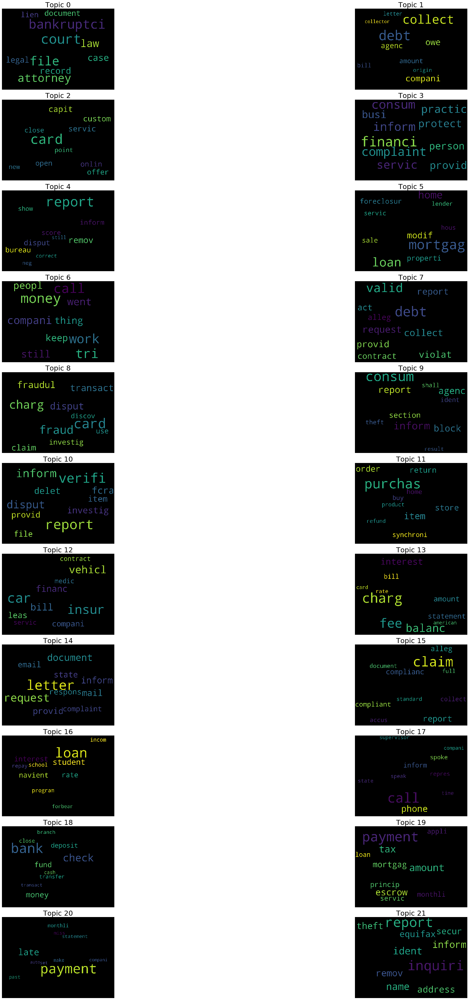

In [46]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.BASE_COLORS.items()]

cloud = WordCloud(stopwords=stop_words,
                  width=2500,
                  height=1800,
                  max_words=10,
                  #colormap='tab10',
                  #color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model22.show_topics(num_topics=lda_model22.num_topics, formatted=False,)

fig, axes = plt.subplots(11, 2, figsize=(50,50), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=25))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

At this point, a field expert could be able to help label these topics. 

For instance: 

* ...

### Dominant topic and its percentage contribution to each document

Each document (or complaint) is composed of multiple topics. But typically only one of the topics is dominant. Let's extract this dominant topic for each complaint and show the weight of the topic and the keywords in a formatted output. This way, we know which document belongs predominantly to which topic.

Let's use the LDA model with 22 topics as an example.

In [47]:
df_original = pd.read_csv("../../complaints-2020-01-22_08_24.csv", encoding="utf-8")
df_original.head(10)

,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,07/23/19,"Credit reporting, credit repair services, or o...",Credit reporting,Credit monitoring or identity theft protection...,Problem canceling credit monitoring or identif...,I have complained many times that the credit r...,Company has responded to the consumer and the ...,Experian Information Solutions Inc.,CA,926XX,None,Consent provided,Web,07/23/19,Closed with explanation,Yes,NaN,3315279
1,07/26/19,Debt collection,I do not know,False statements or representation,Attempted to collect wrong amount,please review the current fraud account and al...,Company believes it acted appropriately as aut...,"Ideal Collection Services, Inc.",FL,333XX,None,Consent provided,Web,07/26/19,Closed with explanation,Yes,NaN,3319487
2,06/03/19,Debt collection,I do not know,Attempts to collect debt not owed,Debt was paid,Called multiple times over the years for a deb...,None,"ONEMAIN FINANCIAL HOLDINGS, LLC.",FL,327XX,None,Consent provided,Web,06/07/19,Closed with explanation,Yes,NaN,3262794
3,07/03/19,Debt collection,Other debt,Attempts to collect debt not owed,Debt was result of identity theft,I sent in a letter to the company to have them...,None,"Diversified Consultants, Inc.",VA,232XX,None,Consent provided,Web,07/03/19,Closed with explanation,Yes,NaN,3295208
4,07/14/19,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Received unsolicited financial product or insu...,On XX/XX/19 I applied for a Debt Relief Produc...,None,"ClearOne Advantage, LLC",PA,191XX,"Older American, Servicemember",Consent provided,Web,07/18/19,Closed with explanation,Yes,NaN,3306130
5,07/20/19,Debt collection,Mortgage debt,Attempts to collect debt not owed,Debt was already discharged in bankruptcy and ...,repeated letters to collect a debt that was wr...,Company believes it acted appropriately as aut...,Ditech Financial LLC,GA,302XX,None,Consent provided,Web,07/20/19,Closed with non-monetary relief,Yes,NaN,3313222
6,06/03/19,"Credit reporting, credit repair services, or o...",Credit reporting,Problem with a credit reporting company's inve...,Their investigation did not fix an error on yo...,The investigation conducted by the 3 major cre...,None,"EQUIFAX, INC.",MO,None,None,Consent provided,Web,06/03/19,Closed with explanation,Yes,NaN,3262053
7,05/31/19,"Credit reporting, credit repair services, or o...",Credit reporting,Incorrect information on your report,Information belongs to someone else,"According to the Fair Credit Reporting Act, Se...",Company has responded to the consumer and the ...,Experian Information Solutions Inc.,HI,967XX,None,Consent provided,Web,05/31/19,Closed with non-monetary relief,Yes,NaN,3259329
8,06/07/19,"Credit reporting, credit repair services, or o...",Credit reporting,Incorrect information on your report,Information belongs to someone else,EXPERIAN HAS SOME INFORMATION ON MY CREDIT REP...,Company has responded to the consumer and the ...,Experian Information Solutions Inc.,FL,None,None,Consent provided,Web,06/07/19,Closed with non-monetary relief,Yes,NaN,3266929
9,06/15/19,"Payday loan, title loan, or personal loan",Installment loan,Problem with the payoff process at the end of ...,None,They would not let me pay my loan off 2 days b...,None,"Big Picture Loans, LLC",IN,477XX,None,Consent provided,Web,06/15/19,Closed with explanation,Yes,NaN,3276316


In [48]:
def format_topics_sentences(ldamodel, corpus, texts):
    # Init output
    complaints_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                complaints_topics_df = complaints_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    complaints_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    complaints_topics_df = pd.concat([complaints_topics_df, contents], axis=1)
    
    return(complaints_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model22, corpus=corpus, texts=df_original['Consumer complaint narrative'])

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']


In [49]:
df_dominant_topic.head(100)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,3.0,0.2874,"financi, consum, complaint, inform, servic, pr...",I have complained many times that the credit r...
1,1,21.0,0.7439,"inquiri, report, ident, name, inform, address,...",please review the current fraud account and al...
2,2,1.0,0.3583,"debt, collect, owe, compani, agenc, amount, bi...",Called multiple times over the years for a deb...
3,3,7.0,0.5786,"debt, valid, request, collect, violat, provid,...",I sent in a letter to the company to have them...
4,4,6.0,0.2926,"money, call, tri, work, compani, went, peopl, ...",On XX/XX/19 I applied for a Debt Relief Produc...
...,...,...,...,...,...
95,95,18.0,0.4611,"bank, check, money, fund, deposit, close, tran...",On XX/XX/XXXX I opened an online savings accou...
96,96,8.0,0.3268,"card, charg, fraud, disput, fraudul, transact,...",I charged a British Airways flight on my Briti...
97,97,6.0,0.2442,"money, call, tri, work, compani, went, peopl, ...","Basically, Chase is so anti-customer, that is ..."
98,98,4.0,0.5823,"report, remov, disput, bureau, inform, score, ...",I have been disputing on my credit report for ...


**Save the above dataframe to csv**

In [50]:
df_dominant_topic.to_csv("corpus_sprint3_LDA_v3_22topics_dominant_topic.csv", index=False)